# Noising Experiments
In this notebook i will:
1. Insert noise (with different parameters, if applicable) in a default image (colored noise k = 6)
2. Extract the metrics of the noised images with different parameters
3. Generate the curve that represents the noise used
4. Insert noise on images of the dataset and see if it gets near the curve generated at step 3

## Gaussian

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
from PIL import Image
from utils.images_generator import gaussian_noise_gs, normalize_img_to_0_255, generate_histogram, colored_noise, uniform_image
from utils.experiments_functions import get_img_info
from itertools import combinations
from skimage import data
from skimage.color import rgb2gray

### Default Image

Generating default image

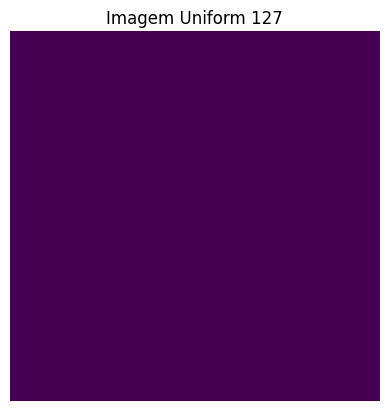

(122, 122)


In [2]:
# generates the default image (uniform)
gs_image = uniform_image(127, (122, 122))
plt.imshow(gs_image)
plt.title(f"Imagem Uniform 127")
plt.axis('off')  # Remove os eixos
plt.show()
print(gs_image.shape)

In [3]:
print(gs_image)

[[127 127 127 ... 127 127 127]
 [127 127 127 ... 127 127 127]
 [127 127 127 ... 127 127 127]
 ...
 [127 127 127 ... 127 127 127]
 [127 127 127 ... 127 127 127]
 [127 127 127 ... 127 127 127]]


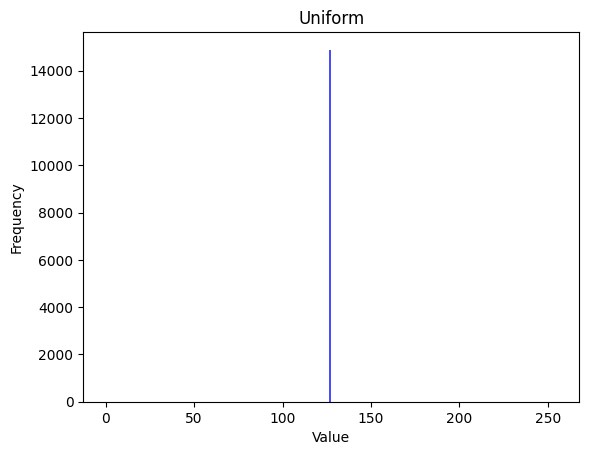

In [4]:
generate_histogram(gs_image, isNormalized=True, title=f'Uniform')

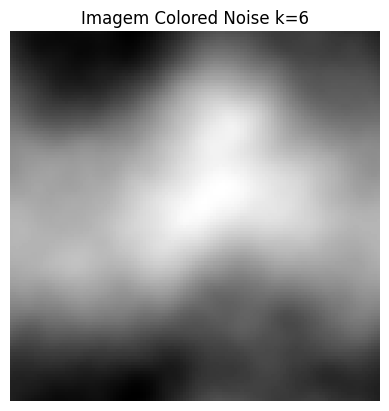

(122, 122)


In [97]:
# generates the default image (colored noise k=6)
gs_image = colored_noise(6, (122, 122))
# normalize to 0-255
gs_image = normalize_img_to_0_255(gs_image)
plt.imshow(gs_image, cmap='gray')
plt.title(f"Imagem Colored Noise k=6")
plt.axis('off')  # Remove os eixos
plt.show()
print(gs_image.shape)

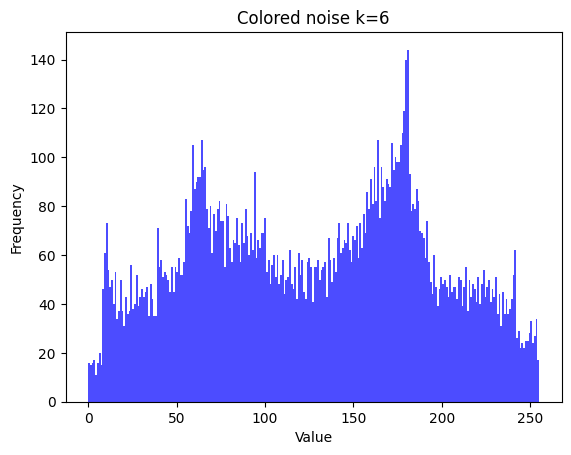

In [98]:
generate_histogram(gs_image, isNormalized=True, title=f'Colored noise k=6')

Generating the noised images

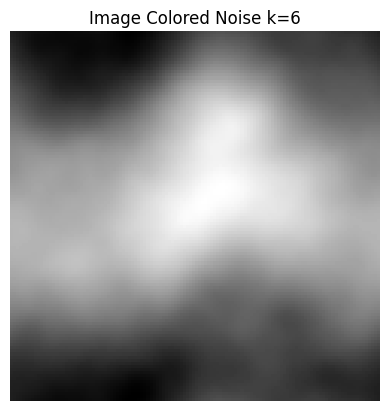

(122, 122)


In [99]:
mean = 0
sigma = 0
noised_image = gaussian_noise_gs(mean, sigma, gs_image)
plt.imshow(noised_image, cmap='gray')
plt.title(f"Image Colored Noise k=6")
plt.axis('off')
plt.show()
print(noised_image.shape)

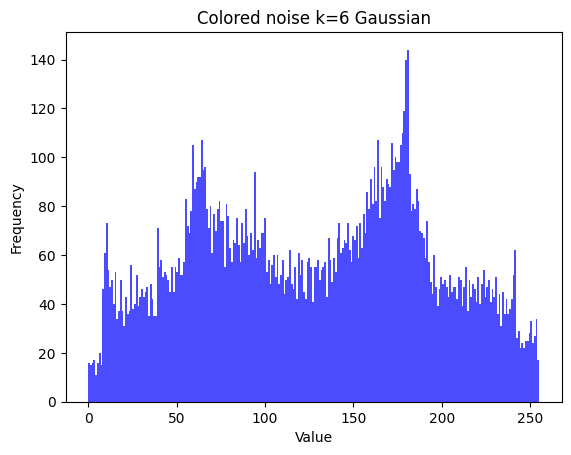

In [100]:
generate_histogram(noised_image, isNormalized=True, title=f'Colored noise k=6 Gaussian')

In [ ]:
# sets the default images 
default_images = {
    'colored_k6':normalize_img_to_0_255(colored_noise(6, (122, 122))),
    'uniform 127':uniform_image(127, (122, 122))
}
# sets the probabilities used
mean_values = [-50, -20, 0, 20, 50]
sd_values = [0, 10, 20, 40, 50]
# stores all the metrics of each image in a list
image_data_list = []
for gs_image_name in default_images:
    gs_image = default_images[gs_image_name]
    for mean_value in mean_values:
        for sd_value in sd_values:
            print(f"Mean = {mean_value}")
            print(f"St Dev = {sd_value}")
            # generate noise image
            print("Generating noised image")
            noised_image = gaussian_noise_gs(mean_value, sd_value, gs_image)
            # extract metrics
            print("Extracting data")
            noised_image_data = get_img_info(noised_image, q_linspace = np.linspace(-2, 20, num = 23))
            # add the information
            noised_image_data['image_name'] = gs_image_name
            noised_image_data['mean_value'] = mean_value
            noised_image_data['sd_value'] = sd_value
            image_data_list.append(noised_image_data)

In [103]:
data_default_aux = pd.concat(image_data_list, ignore_index=True)

In [ ]:
data_default_aux.to_csv(f"results/noise_analysis/gaussian/gaussian_analysis_default.csv", index = False)

### Dataset Images
1. Take 1 image from each of the 25 classes of the Sintorn Dataset
2. Insert noise with different probabilities
3. extract metrics and insert in the previous dataframe

In [29]:
# reads 1 image from each class
images_path = f'data/Sintorn/hardware'
rot = 'r000'
seg = 's001'
images_filenames = []
for file in os.listdir(images_path):
    if file.endswith(f"{rot}-{seg}.png"):
        images_filenames.append(file)
print(len(images_filenames))

25


In [30]:
print(images_filenames)

['canesugar01-r000-s001.png', 'canvas01-r000-s001.png', 'couscous01-r000-s001.png', 'fabric01-r000-s001.png', 'fabric02-r000-s001.png', 'fabric03-r000-s001.png', 'fabric04-r000-s001.png', 'fabric05-r000-s001.png', 'flaxseed01-r000-s001.png', 'knitwear01-r000-s001.png', 'knitwear02-r000-s001.png', 'knitwear03-r000-s001.png', 'lentils01-r000-s001.png', 'oatmeal01-r000-s001.png', 'pearlsugar01-r000-s001.png', 'rice01-r000-s001.png', 'rug01-r000-s001.png', 'ryeflakes01-r000-s001.png', 'seeds01-r000-s001.png', 'seeds02-r000-s001.png', 'sprinkles01-r000-s001.png', 'tile01-r000-s001.png', 'towel01-r000-s001.png', 'wheat01-r000-s001.png', 'wool01-r000-s001.png']


Testing histogram

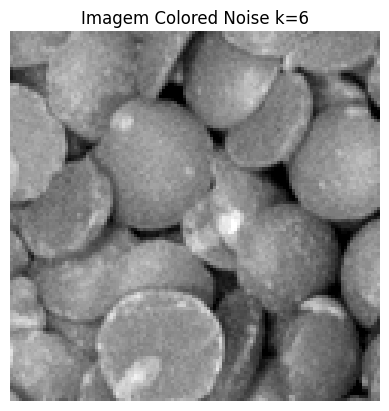

(122, 122)


In [31]:
img_filename = images_filenames[3]
img_filename = "lentils01-r000-s001.png"
gs_image = cv2.imread(f'{images_path}/{img_filename}', cv2.IMREAD_GRAYSCALE)
plt.imshow(gs_image, cmap='gray')
plt.title(f"Imagem Colored Noise k=6")
plt.axis('off')  # Remove os eixos
plt.show()
print(gs_image.shape)

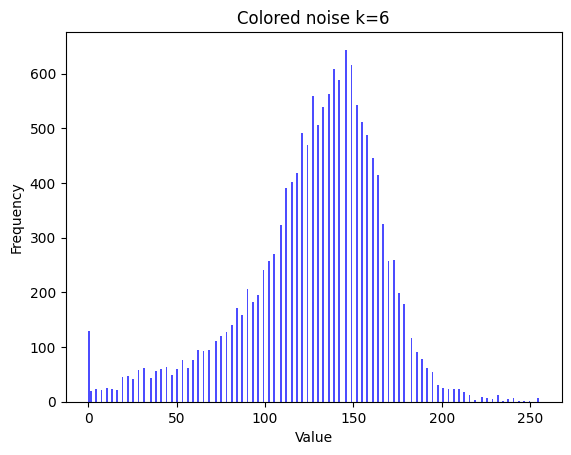

In [9]:
generate_histogram(gs_image, isNormalized=True, title=f'Colored noise k=6')

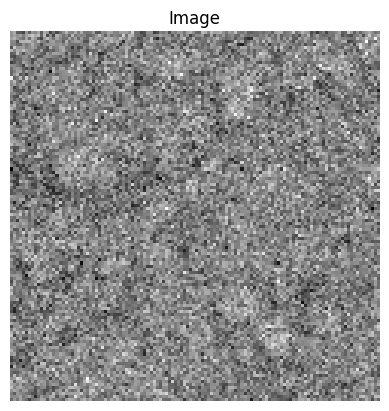

(122, 122)


In [16]:
noised_image = gaussian_noise_gs(0, 90, gs_image)
plt.imshow(noised_image, cmap='gray')
plt.title(f"Image")
plt.axis('off')
plt.show()
print(noised_image.shape)

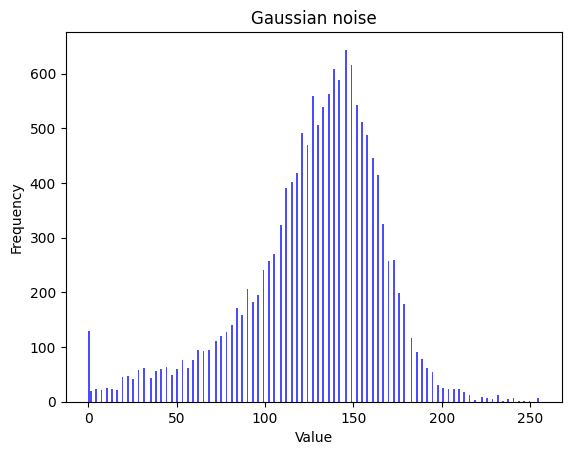

In [11]:
generate_histogram(noised_image, isNormalized=True, title=f'Gaussian noise')

Extracting metrics for each image with each parameter

In [ ]:
mean_values = [-30, 0, 30]
sd_values = [0, 20, 50]
image_data_list = []
for idx, img_filename in enumerate(images_filenames):
    # reads the image
    gs_image = cv2.imread(f'{images_path}/{img_filename}', cv2.IMREAD_GRAYSCALE)
    image_title = img_filename.split('.')[0]
    print(image_title, f"{idx+1}/{len(images_filenames)}")
    # adds noise
    for mean_value in mean_values:
        for sd_value in sd_values:
            print(f"Mean = {mean_value}")
            print(f"St Dev = {sd_value}")
            # generate noise image
            print("Generating noised image")
            noised_image = gaussian_noise_gs(mean_value, sd_value, gs_image)
            # extract metrics
            print("Extracting data")
            noised_image_data = get_img_info(noised_image, q_linspace = np.linspace(-2, 20, num = 23))
            # add the information
            noised_image_data['image_name'] = img_filename
            noised_image_data['mean_value'] = mean_value
            noised_image_data['sd_value'] = sd_value
            image_data_list.append(noised_image_data)


In [112]:
data_ss = pd.concat(image_data_list, ignore_index=True)
data_ss.to_csv(f"results/noise_analysis/gaussian/gaussian_analysis.csv", index = False)

Extracting metrics for each image with MORE parameter and less values of 'q'
18/12/2024

In [ ]:
mean_values = [-50, -30, -10, 0, 10, 30, 50]
sd_values = [0, 10, 20, 30, 40, 50, 60, 70]
q_values = [0, 2, 5, 10]
image_data_list = []
for idx, img_filename in enumerate(images_filenames):
    # reads the image
    gs_image = cv2.imread(f'{images_path}/{img_filename}', cv2.IMREAD_GRAYSCALE)
    image_title = img_filename.split('.')[0]
    print(image_title, f"{idx+1}/{len(images_filenames)}")
    # no noise data
    not_noised_image_data = get_img_info(gs_image, q_linspace = q_values)
    # adds noise
    for mean_value in mean_values:
        for sd_value in sd_values:
            print(f"Mean = {mean_value}")
            print(f"St Dev = {sd_value}")
            noised_image_data = not_noised_image_data
            if sd_value != 0:
                # there is noise
                # generate noise image
                print("Generating noised image")
                noised_image = gaussian_noise_gs(mean_value, sd_value, gs_image)
                # extract metrics
                print("Extracting data")
                noised_image_data = get_img_info(noised_image, q_linspace = q_values)                
            # add the information
            noised_image_data['image_name'] = img_filename
            noised_image_data['mean_value'] = mean_value
            noised_image_data['sd_value'] = sd_value
            image_data_list.append(noised_image_data)
data_ss = pd.concat(image_data_list, ignore_index=True)
data_ss.to_csv(f"results/noise_analysis/gaussian/gaussian_analysis_v2.csv", index = False)

canesugar01-r000-s001 1/25
Mean = -50
St Dev = 0
Mean = -50
St Dev = 10
Generating noised image
Extracting data
Mean = -50
St Dev = 20
Generating noised image
Extracting data
Mean = -50
St Dev = 30
Generating noised image
Extracting data
Mean = -50
St Dev = 40
Generating noised image
Extracting data
Mean = -50
St Dev = 50
Generating noised image
Extracting data
Mean = -50
St Dev = 60
Generating noised image
Extracting data
Mean = -50
St Dev = 70
Generating noised image
Extracting data
Mean = -30
St Dev = 0
Mean = -30
St Dev = 10
Generating noised image
Extracting data
Mean = -30
St Dev = 20
Generating noised image
Extracting data
Mean = -30
St Dev = 30
Generating noised image
Extracting data
Mean = -30
St Dev = 40
Generating noised image
Extracting data
Mean = -30
St Dev = 50
Generating noised image
Extracting data
Mean = -30
St Dev = 60
Generating noised image
Extracting data
Mean = -30
St Dev = 70
Generating noised image
Extracting data
Mean = -10
St Dev = 0
Mean = -10
St Dev = 10
Ge

### Extracting metrics for SKIMAGE images

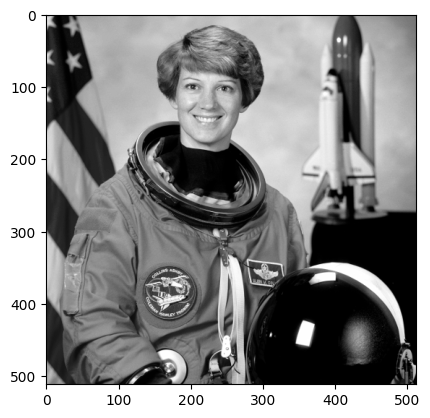

In [18]:
astronaut_image = data.astronaut()
astronaut_image = rgb2gray(astronaut_image)
plt.imshow(astronaut_image, cmap='gray')

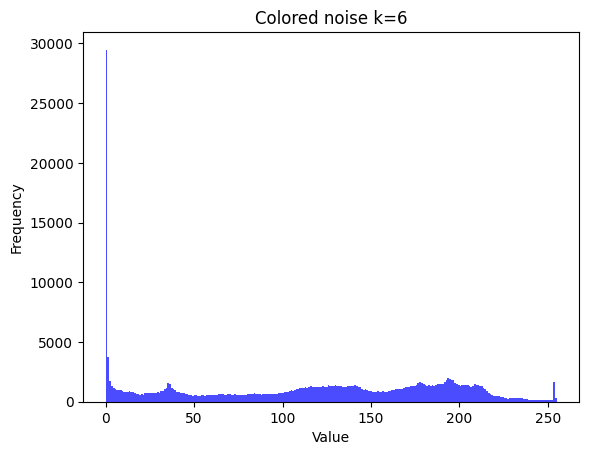

In [20]:
generate_histogram(astronaut_image, isNormalized=False, title=f'Colored noise k=6')

In [ ]:
noised_image = gaussian_noise_gs(mean_value, sd_value, gs_image)

In [25]:
skimage_images = {
    'data.astronaut': rgb2gray(data.astronaut())*255,
    'data.cat': rgb2gray(data.cat())*255,
    'data.coins': data.coins()
}

In [23]:
mean_values = [-50, -20, 0, 20, 50]
sd_values = [0, 10, 20, 40, 50]
image_data_list = []
for idx,skimage_name in enumerate(skimage_images):
    # reads the image
    gs_image = skimage_images[skimage_name]
    image_title = skimage_name.split('.')[1]
    print(image_title, f"{idx+1}/{len(skimage_images)}")
    # adds noise
    for mean_value in mean_values:
        for sd_value in sd_values:
            print(f"Mean = {mean_value}")
            print(f"St Dev = {sd_value}")
            # generate noise image
            print("Generating noised image")
            noised_image = gaussian_noise_gs(mean_value, sd_value, gs_image)
            # extract metrics
            print("Extracting data")
            noised_image_data = get_img_info(noised_image, q_linspace = [0])
            # add the information
            noised_image_data['image_name'] = skimage_name
            noised_image_data['mean_value'] = mean_value
            noised_image_data['sd_value'] = sd_value
            image_data_list.append(noised_image_data)


astronaut 1/3
Mean = -50
St Dev = 0
Generating noised image
Extracting data
Mean = -50
St Dev = 10
Generating noised image
Extracting data
Mean = -50
St Dev = 20
Generating noised image
Extracting data
Mean = -50
St Dev = 40
Generating noised image
Extracting data
Mean = -50
St Dev = 50
Generating noised image
Extracting data
Mean = -20
St Dev = 0
Generating noised image
Extracting data
Mean = -20
St Dev = 10
Generating noised image
Extracting data
Mean = -20
St Dev = 20
Generating noised image
Extracting data
Mean = -20
St Dev = 40
Generating noised image
Extracting data
Mean = -20
St Dev = 50
Generating noised image
Extracting data
Mean = 0
St Dev = 0
Generating noised image
Extracting data
Mean = 0
St Dev = 10
Generating noised image
Extracting data
Mean = 0
St Dev = 20
Generating noised image
Extracting data
Mean = 0
St Dev = 40
Generating noised image
Extracting data
Mean = 0
St Dev = 50
Generating noised image
Extracting data
Mean = 20
St Dev = 0
Generating noised image
Extractin

Saving the images

In [27]:
mean_values = [-50, -20, 0, 20, 50]
mean_values = [50]
sd_values = [0, 10, 20, 40, 50]
sd_values = [0, 20, 50]
image_data_list = []
results_image_path = "results/noise_analysis/q0/gaussian/images"
for idx,skimage_name in enumerate(skimage_images):
    # reads the image
    gs_image = skimage_images[skimage_name]
    image_title = skimage_name.split('.')[1]
    print(image_title, f"{idx+1}/{len(skimage_images)}")
    # adds noise
    for mean_value in mean_values:
        for sd_value in sd_values:
            print(f"Mean = {mean_value}")
            print(f"St Dev = {sd_value}")
            # generate noise image
            print("Generating noised image")
            noised_image = gaussian_noise_gs(mean_value, sd_value, gs_image)
            # saving
            im = Image.fromarray(noised_image)
            im = im.convert('RGB')
            im.save(f"{results_image_path}/{image_title}-sd-{sd_value}.png")
            


astronaut 1/3
Mean = 50
St Dev = 0
Generating noised image
Mean = 50
St Dev = 20
Generating noised image
Mean = 50
St Dev = 50
Generating noised image
cat 2/3
Mean = 50
St Dev = 0
Generating noised image
Mean = 50
St Dev = 20
Generating noised image
Mean = 50
St Dev = 50
Generating noised image
coins 3/3
Mean = 50
St Dev = 0
Generating noised image
Mean = 50
St Dev = 20
Generating noised image
Mean = 50
St Dev = 50
Generating noised image


In [24]:
data_default_aux = pd.concat(image_data_list, ignore_index=True)
data_default_aux.to_csv(f"results/noise_analysis/gaussian/gaussian_analysis_skimage_v2.csv", index = False)

### Plotting

In [2]:
image_data = pd.read_csv(f"results/noise_analysis/gaussian/gaussian_analysis.csv")
image_data_default = pd.read_csv(f"results/noise_analysis/gaussian/gaussian_analysis_default.csv")
image_data.head()

,q,Smoothness,Curve structure,Weighted Entropy Correct,Weighted Complexity Correct,prob0,prob1,prob2,image_name,mean_value,sd_value
0,-2.0,NaN,0.000000,-0.000000,NaN,NaN,0.000000,0.000000,canesugar01-r000-s001.png,-30,0
1,-1.0,NaN,0.000000,-0.000000,NaN,NaN,0.000000,0.000000,canesugar01-r000-s001.png,-30,0
2,0.0,0.230972,0.193908,0.932321,0.084523,0.564306,0.314801,0.120893,canesugar01-r000-s001.png,-30,0
3,1.0,0.311469,0.222770,0.904898,0.120397,0.644803,0.288984,0.066214,canesugar01-r000-s001.png,-30,0
4,2.0,0.379436,0.225311,0.868004,0.164374,0.712770,0.256271,0.030960,canesugar01-r000-s001.png,-30,0


In [3]:
filenames = image_data.image_name.unique()
print(filenames)

['canesugar01-r000-s001.png' 'canvas01-r000-s001.png'
 'couscous01-r000-s001.png' 'fabric01-r000-s001.png'
 'fabric02-r000-s001.png' 'fabric03-r000-s001.png'
 'fabric04-r000-s001.png' 'fabric05-r000-s001.png'
 'flaxseed01-r000-s001.png' 'knitwear01-r000-s001.png'
 'knitwear02-r000-s001.png' 'knitwear03-r000-s001.png'
 'lentils01-r000-s001.png' 'oatmeal01-r000-s001.png'
 'pearlsugar01-r000-s001.png' 'rice01-r000-s001.png' 'rug01-r000-s001.png'
 'ryeflakes01-r000-s001.png' 'seeds01-r000-s001.png'
 'seeds02-r000-s001.png' 'sprinkles01-r000-s001.png'
 'tile01-r000-s001.png' 'towel01-r000-s001.png' 'wheat01-r000-s001.png'
 'wool01-r000-s001.png']


In [4]:
# default_data = image_data[(image_data['image_name'] == 'default')]
default_data = image_data_default # pega mais valores de probabilidade de s&p
dataset_data = image_data[(image_data['image_name'] != 'colored_k6') & (image_data['image_name'] != 'uniform 127')]

In [5]:
print(dataset_data.shape)
dataset_data.head()

(5175, 11)


,q,Smoothness,Curve structure,Weighted Entropy Correct,Weighted Complexity Correct,prob0,prob1,prob2,image_name,mean_value,sd_value
0,-2.0,NaN,0.000000,-0.000000,NaN,NaN,0.000000,0.000000,canesugar01-r000-s001.png,-30,0
1,-1.0,NaN,0.000000,-0.000000,NaN,NaN,0.000000,0.000000,canesugar01-r000-s001.png,-30,0
2,0.0,0.230972,0.193908,0.932321,0.084523,0.564306,0.314801,0.120893,canesugar01-r000-s001.png,-30,0
3,1.0,0.311469,0.222770,0.904898,0.120397,0.644803,0.288984,0.066214,canesugar01-r000-s001.png,-30,0
4,2.0,0.379436,0.225311,0.868004,0.164374,0.712770,0.256271,0.030960,canesugar01-r000-s001.png,-30,0


Plotting the curve for each noise parameter


In [6]:
mean_values = [-50, -20, 0, 20, 50]
sd_values = [10, 20, 40, 50]

In [7]:
def truncate(f, n):
    '''Truncates/pads a float f to n decimal places without rounding'''
    s = '{}'.format(f)
    if 'e' in s or 'E' in s:
        return '{0:.{1}f}'.format(f, n)
    i, p, d = s.partition('.')
    return '.'.join([i, (d+'0'*n)[:n]])
truncate(0.05532, 2)

'0.05'

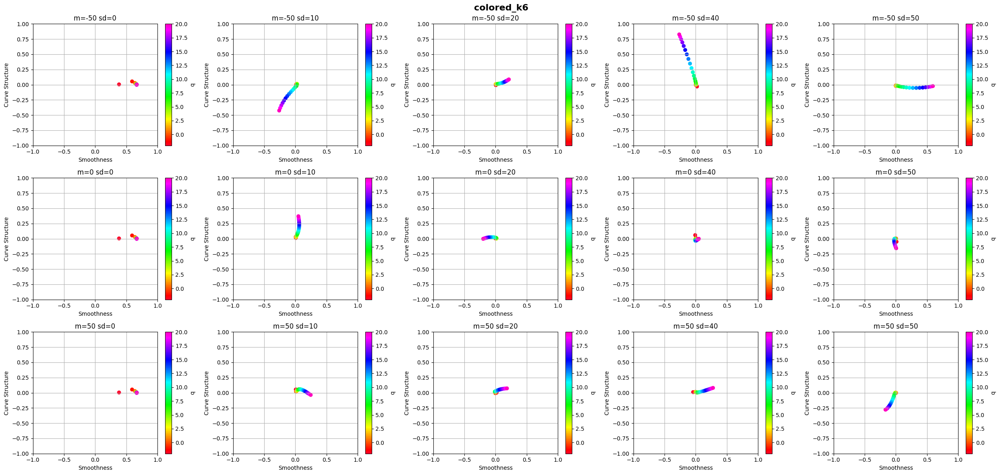

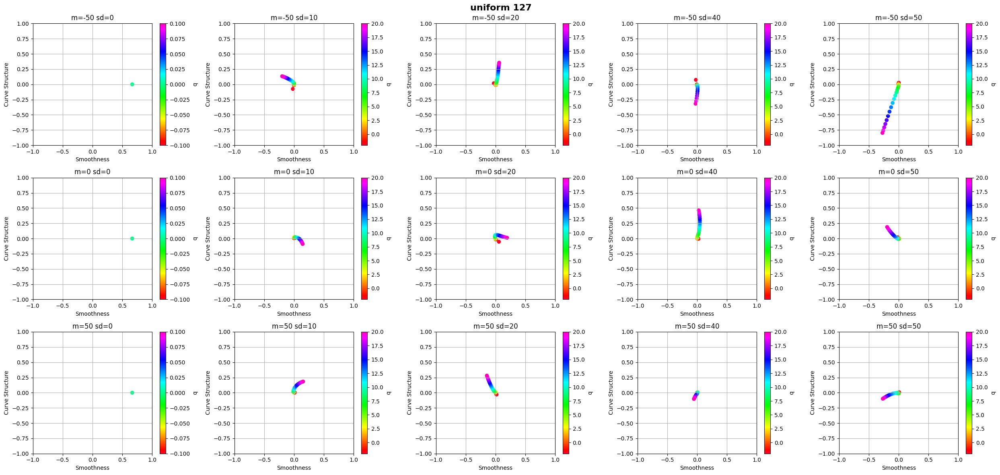

In [171]:
unique_default_images = default_data['image_name'].unique()
mean_values = [-50, -20, 0, 20, 50]
mean_values_chosen = [-50, 0, 50]
sd_values = [0, 10, 20, 40, 50]
sd_values_chosen = sd_values
# Choose some probs to plot
ncolsChosen = len(sd_values_chosen)
nrowsChosen = len(mean_values_chosen)

for i, imageName in enumerate(unique_default_images):
    # Filter DataFrame for the current imagename
    df_data_filtered = default_data[default_data['image_name'] == imageName]

    fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(25, 4 * nrowsChosen))
    # Flatten the axs array for easier indexing
    # axs = axs.flatten()

    for i_sd, mean_value in enumerate(mean_values_chosen):
        for j_mean, sd_value in enumerate(sd_values):
            # Filter DataFrame for the current noise_prob
            df_filtered = df_data_filtered[(df_data_filtered['mean_value'] == mean_value) & (df_data_filtered['sd_value'] == sd_value)]

            # Create scatter plot for Smoothness vs. Curve structure, colored by q
            scatter = axs[i_sd][j_mean].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                                    c=df_filtered['q'], cmap='gist_rainbow')

            # Add colorbar for each subplot
            cbar = fig.colorbar(scatter, ax=axs[i_sd][j_mean])
            cbar.set_label('q')

            # Set title and labels for the subplot
            axs[i_sd][j_mean].set_title(f'm={mean_value} sd={sd_value}')
            axs[i_sd][j_mean].set_xlabel('Smoothness')
            axs[i_sd][j_mean].set_ylabel('Curve Structure')
            axs[i_sd][j_mean].set_xlim([-1, 1])
            axs[i_sd][j_mean].set_ylim([-1, 1])
            axs[i_sd][j_mean].grid(True)

    plt.suptitle(imageName,fontsize=16, fontweight='bold')
    # Adjust layout to prevent overlap
    plt.tight_layout()
    # Save
    plt.savefig(f'results/noise_analysis/gaussian/planes/default_{imageName}.png', bbox_inches='tight')
    # # Show the plot
    # plt.show()

Plotting noise characteristic curve

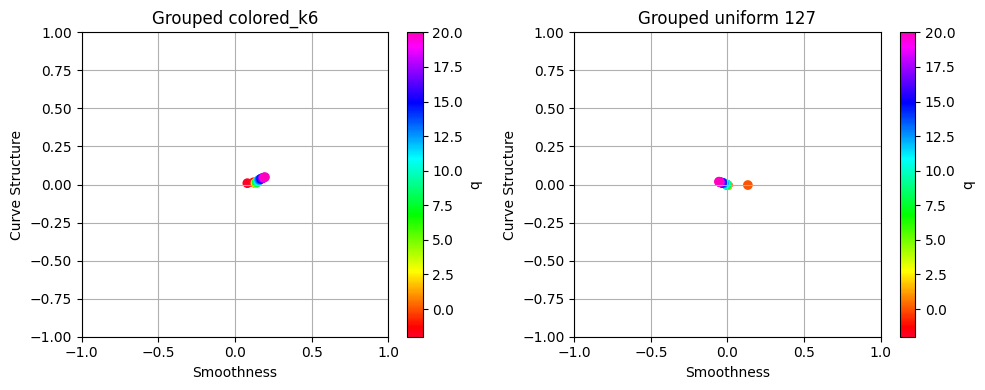

In [142]:
unique_default_images = default_data['image_name'].unique()
ncolsChosen = 2
nrowsChosen = int(np.ceil(len(unique_default_images)/ncolsChosen))
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(10, 4 * nrowsChosen))

for i, imageName in enumerate(unique_default_images):
    # Filter DataFrame for the current imagename
    df_data_filtered = default_data[default_data['image_name'] == imageName]

    grouped_default = df_data_filtered.groupby('q')[['Smoothness', 'Curve structure', 'Weighted Entropy Correct','Weighted Complexity Correct']].mean()
    grouped_default = grouped_default.reset_index()

    # Create scatter plot for Smoothness vs. Curve structure, colored by q
    scatter = axs[i].scatter(grouped_default['Smoothness'], grouped_default['Curve structure'], 
                             c=grouped_default['q'], cmap='gist_rainbow')

    # Add colorbar for each subplot
    cbar = fig.colorbar(scatter, ax=axs[i])
    cbar.set_label('q')

    # Set title and labels for the subplot
    axs[i].set_title(f'Grouped {imageName}')
    axs[i].set_xlabel('Smoothness')
    axs[i].set_ylabel('Curve Structure')
    axs[i].set_xlim([-1, 1])
    axs[i].set_ylim([-1, 1])
    axs[i].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/gaussian/planes/default_grouped.png', bbox_inches='tight')
# Show the plot
plt.show()

Plotting from images

In [7]:
filenames_dataset = dataset_data.image_name.unique()
print(filenames_dataset)

['canesugar01-r000-s001.png' 'canvas01-r000-s001.png'
 'couscous01-r000-s001.png' 'fabric01-r000-s001.png'
 'fabric02-r000-s001.png' 'fabric03-r000-s001.png'
 'fabric04-r000-s001.png' 'fabric05-r000-s001.png'
 'flaxseed01-r000-s001.png' 'knitwear01-r000-s001.png'
 'knitwear02-r000-s001.png' 'knitwear03-r000-s001.png'
 'lentils01-r000-s001.png' 'oatmeal01-r000-s001.png'
 'pearlsugar01-r000-s001.png' 'rice01-r000-s001.png' 'rug01-r000-s001.png'
 'ryeflakes01-r000-s001.png' 'seeds01-r000-s001.png'
 'seeds02-r000-s001.png' 'sprinkles01-r000-s001.png'
 'tile01-r000-s001.png' 'towel01-r000-s001.png' 'wheat01-r000-s001.png'
 'wool01-r000-s001.png']


In [8]:
chosen_filenames = np.random.choice(filenames_dataset, 10)
chosen_filenames

array(['fabric03-r000-s001.png', 'lentils01-r000-s001.png',
       'seeds02-r000-s001.png', 'rug01-r000-s001.png',
       'wheat01-r000-s001.png', 'pearlsugar01-r000-s001.png',
       'seeds02-r000-s001.png', 'fabric02-r000-s001.png',
       'fabric01-r000-s001.png', 'oatmeal01-r000-s001.png'], dtype=object)

['wheat01-r000-s001.png' 'tile01-r000-s001.png' 'seeds01-r000-s001.png'
 'seeds02-r000-s001.png' 'fabric01-r000-s001.png'
 'canesugar01-r000-s001.png' 'ryeflakes01-r000-s001.png'
 'canesugar01-r000-s001.png' 'canvas01-r000-s001.png'
 'sprinkles01-r000-s001.png' 'pearlsugar01-r000-s001.png'
 'rug01-r000-s001.png' 'towel01-r000-s001.png' 'flaxseed01-r000-s001.png'
 'wheat01-r000-s001.png']


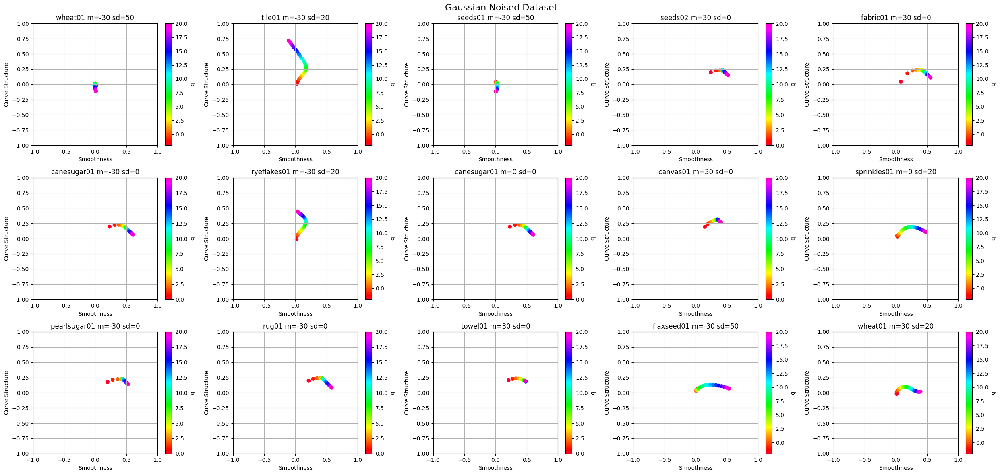

In [170]:
chosen_filenames = np.random.choice(filenames_dataset, 15)
print(chosen_filenames)

mean_values = [-30, 0, 30]
sd_values = [0, 20, 50]
ncolsChosen = 5
nrowsChosen = int(np.ceil(len(chosen_filenames)/ncolsChosen))
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(25, 4 * nrowsChosen))
# Flatten the axs array for easier indexing
axs = axs.flatten()
for i, imageName in enumerate(chosen_filenames):
    # pick a mean and sd
    mean_chosen = np.random.choice(mean_values)
    sd_chosen = np.random.choice(sd_values)

    # Filter DataFrame for the current imageName and probability
    df_filtered = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == mean_chosen) & (image_data['sd_value'] == sd_chosen)]


    # Create scatter plot for Smoothness vs. Curve structure, colored by q
    scatter = axs[i].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                             c=df_filtered['q'], cmap='gist_rainbow')

    # Add colorbar for each subplot
    cbar = fig.colorbar(scatter, ax=axs[i])
    cbar.set_label('q')

    # Set title and labels for the subplot
    axs[i].set_title(f'{imageName.split('-')[0]} m={mean_chosen} sd={sd_chosen}')
    axs[i].set_xlabel('Smoothness')
    axs[i].set_ylabel('Curve Structure')
    axs[i].set_xlim([-1, 1])
    axs[i].set_ylim([-1, 1])
    axs[i].grid(True)
# Turn off any unused subplots
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.suptitle('Gaussian Noised Dataset', fontsize=16)
# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/gaussian/planes/gaussian_dataset_sample.png', bbox_inches='tight')
# Show the plot
plt.show()

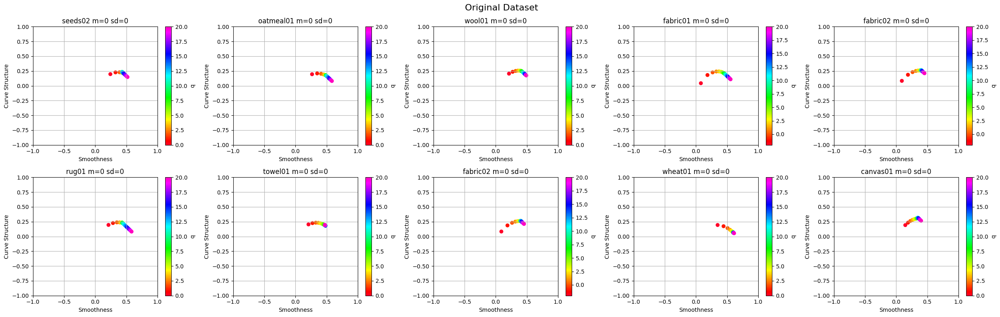

In [151]:
mean_values = [-30, 0, 30]
sd_values = [0, 20, 50]
ncolsChosen = 5
nrowsChosen = int(np.ceil(len(chosen_filenames)/ncolsChosen))
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(25, 4 * nrowsChosen))
# Flatten the axs array for easier indexing
axs = axs.flatten()
for i, imageName in enumerate(chosen_filenames):
    # pick a mean and sd
    mean_chosen = 0
    sd_chosen = 0

    # Filter DataFrame for the current imageName and probability
    df_filtered = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == mean_chosen) & (image_data['sd_value'] == sd_chosen)]


    # Create scatter plot for Smoothness vs. Curve structure, colored by q
    scatter = axs[i].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                             c=df_filtered['q'], cmap='gist_rainbow')

    # Add colorbar for each subplot
    cbar = fig.colorbar(scatter, ax=axs[i])
    cbar.set_label('q')

    # Set title and labels for the subplot
    axs[i].set_title(f'{imageName.split('-')[0]} m={mean_chosen} sd={sd_chosen}')
    axs[i].set_xlabel('Smoothness')
    axs[i].set_ylabel('Curve Structure')
    axs[i].set_xlim([-1, 1])
    axs[i].set_ylim([-1, 1])
    axs[i].grid(True)
# Turn off any unused subplots
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.suptitle('Original Dataset', fontsize=16)
# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/gaussian/planes/no_noise_dataset_sample.png', bbox_inches='tight')
# Show the plot
plt.show()

['wheat01-r000-s001.png' 'fabric05-r000-s001.png' 'wool01-r000-s001.png'
 'flaxseed01-r000-s001.png' 'couscous01-r000-s001.png']


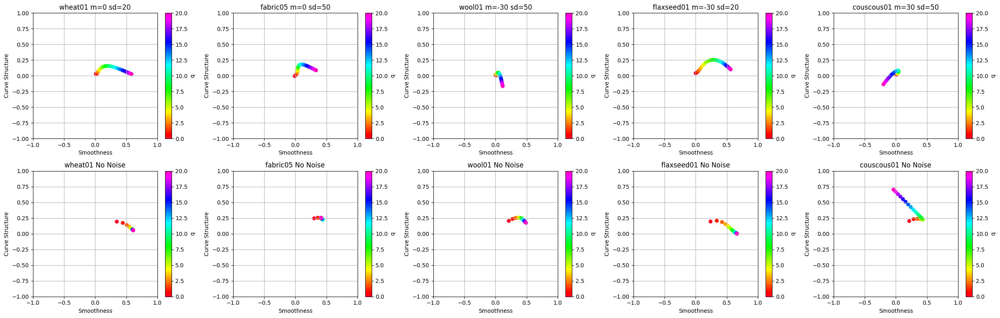

In [168]:
mean_values = [-30, 0, 30]
# sd_values = [0, 20, 50]
sd_values = [20, 50] # dont wants sd=0
ncolsChosen = 5
chosen_filenames = np.random.choice(filenames_dataset, ncolsChosen, replace=False)
print(chosen_filenames)
# nrowsChosen = int(np.ceil(len(chosen_filenames)/ncolsChosen))
nrowsChosen = 2
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(25, 4 * nrowsChosen))
# Flatten the axs array for easier indexing
# axs = axs.flatten()
for i, imageName in enumerate(chosen_filenames):
    # pick a mean and sd
    mean_chosen = np.random.choice(mean_values)
    sd_chosen = np.random.choice(sd_values)

    # Filter DataFrame for the current imageName and probability
    df_filtered = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == mean_chosen) & (image_data['sd_value'] == sd_chosen)]
    df_filtered_no_noise = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == 0) & (image_data['sd_value'] == 0)]


    # Create scatter plot for Smoothness vs. Curve structure, colored by q
    scatter = axs[0][i].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                             c=df_filtered['q'], cmap='gist_rainbow')
    scatter = axs[1][i].scatter(df_filtered_no_noise['Smoothness'], df_filtered_no_noise['Curve structure'], 
                             c=df_filtered_no_noise['q'], cmap='gist_rainbow')

    for j in range(2):
        # Add colorbar for each subplot
        cbar = fig.colorbar(scatter, ax=axs[j][i])
        cbar.set_label('q')

        # Set title and labels for the subplot
        axs[j][i].set_title(f"{imageName.split('-')[0]} {f'm={mean_chosen} sd={sd_chosen}' if (j==0) else 'No Noise'}")
        axs[j][i].set_xlabel('Smoothness')
        axs[j][i].set_ylabel('Curve Structure')
        axs[j][i].set_xlim([-1, 1])
        axs[j][i].set_ylim([-1, 1])
        axs[j][i].grid(True)
# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/gaussian/planes/gaussian_dataset_sample_comparing_v1.png', bbox_inches='tight')
# Show the plot
plt.show()

In [ ]:
mean_values = [-30, 0, 30]
# sd_values = [0, 20, 50]
sd_values = [20, 50] # dont wants sd=0
amountOfImages = 25 # must be less or equal to 25
ncolsChosen = 4
chosen_filenames = np.random.choice(filenames_dataset, amountOfImages, replace=False)
print(chosen_filenames)
# nrowsChosen = int(np.ceil(len(chosen_filenames)/ncolsChosen))
nrowsChosen = amountOfImages
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(20, 4* nrowsChosen))
# Flatten the axs array for easier indexing
# axs = axs.flatten()
images_path = f'data/Sintorn/hardware'
for i, imageName in enumerate(chosen_filenames):
    # read image
    img_filename = images_filenames[3]
    gs_image = cv2.imread(f'{images_path}/{imageName}', cv2.IMREAD_GRAYSCALE)
    # pick a mean and sd
    mean_chosen = np.random.choice(mean_values)
    sd_chosen = np.random.choice(sd_values)

    # noised image
    noised_image = gaussian_noise_gs(mean_chosen, sd_chosen, gs_image)

    # Filter DataFrame for the current imageName and probability
    df_filtered = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == mean_chosen) & (image_data['sd_value'] == sd_chosen)]
    df_filtered_no_noise = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == 0) & (image_data['sd_value'] == 0)]


    # Create scatter plot for Smoothness vs. Curve structure, colored by q
    axs[i][0].imshow(gs_image, cmap='gray')
    scatter = axs[i][1].scatter(df_filtered_no_noise['Smoothness'], df_filtered_no_noise['Curve structure'], 
                             c=df_filtered_no_noise['q'], cmap='gist_rainbow')
    axs[i][2].imshow(noised_image, cmap='gray')
    scatter = axs[i][3].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                             c=df_filtered['q'], cmap='gist_rainbow')

    axs[i][0].set_title(f"{imageName.split('-')[0]}")
    axs[i][2].set_title(f"{imageName.split('-')[0]} Noised")
    for j in [1, 3]:

        # Add colorbar for each subplot
        cbar = fig.colorbar(scatter, ax=axs[i][j])
        cbar.set_label('q')
        # Set title and labels for the subplot
        axs[i][j].set_title(f"{imageName.split('-')[0]} {f'm={mean_chosen} sd={sd_chosen}' if (j==3) else 'No Noise'}")
        axs[i][j].set_xlabel('Smoothness')
        axs[i][j].set_ylabel('Curve Structure')
        axs[i][j].set_xlim([-1, 1])
        axs[i][j].set_ylim([-1, 1])
        axs[i][j].grid(True)
# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/gaussian/planes/gaussian_dataset_sample_comparing_v2.png', bbox_inches='tight')
# Show the plot
plt.show()

['canesugar01-r000-s001.png' 'canvas01-r000-s001.png'
 'couscous01-r000-s001.png' 'fabric01-r000-s001.png'
 'fabric02-r000-s001.png' 'fabric03-r000-s001.png'
 'fabric04-r000-s001.png' 'fabric05-r000-s001.png'
 'flaxseed01-r000-s001.png' 'knitwear01-r000-s001.png'
 'knitwear02-r000-s001.png' 'knitwear03-r000-s001.png'
 'lentils01-r000-s001.png' 'oatmeal01-r000-s001.png'
 'pearlsugar01-r000-s001.png' 'rice01-r000-s001.png' 'rug01-r000-s001.png'
 'ryeflakes01-r000-s001.png' 'seeds01-r000-s001.png'
 'seeds02-r000-s001.png' 'sprinkles01-r000-s001.png'
 'tile01-r000-s001.png' 'towel01-r000-s001.png' 'wheat01-r000-s001.png'
 'wool01-r000-s001.png']


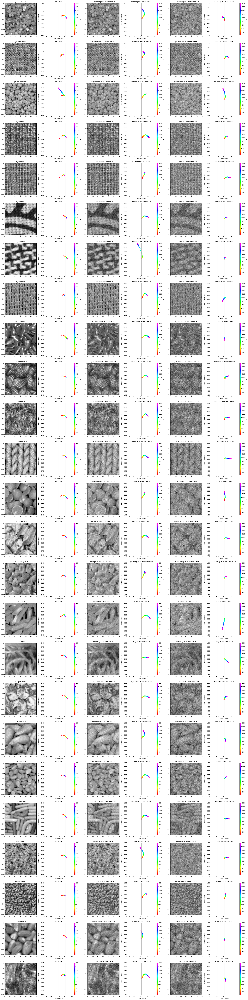

In [35]:
mean_values = [-30, 0, 30]
# sd_values = [0, 20, 50]
sd_values = [20, 50] # dont wants sd=0
amountOfImages = 25 # must be less or equal to 25
ncolsChosen = 6
chosen_filenames = np.random.choice(filenames_dataset, amountOfImages, replace=False)
chosen_filenames.sort()
print(chosen_filenames)
# nrowsChosen = int(np.ceil(len(chosen_filenames)/ncolsChosen))
nrowsChosen = amountOfImages
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(25, 4* nrowsChosen))
# Flatten the axs array for easier indexing
# axs = axs.flatten()
images_path = f'data/Sintorn/hardware'
for i, imageName in enumerate(chosen_filenames):
    # read image
    gs_image = cv2.imread(f'{images_path}/{imageName}', cv2.IMREAD_GRAYSCALE)
    # pick a mean and sd
    mean_chosen = np.random.choice(mean_values)
    sd_chosen = np.random.choice(sd_values)

    df_filtered_no_noise = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == 0) & (image_data['sd_value'] == 0)]
    axs[i][0].imshow(gs_image, cmap='gray')
    scatter = axs[i][1].scatter(df_filtered_no_noise['Smoothness'], df_filtered_no_noise['Curve structure'], 
                             c=df_filtered_no_noise['q'], cmap='gist_rainbow')
    axs[i][0].set_title(f"({i+1})-{imageName.split('-')[0]}")
    scatter_idxs = [(1, 0)]
    for idx, sd_chosen in enumerate(sd_values):
        # noised image
        noised_image = gaussian_noise_gs(mean_chosen, sd_chosen, gs_image)

        # Filter DataFrame for the current imageName and probability
        df_filtered = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == mean_chosen) & (image_data['sd_value'] == sd_chosen)]


        # Create scatter plot for Smoothness vs. Curve structure, colored by q
        axs[i][2+idx*2].imshow(noised_image, cmap='gray')
        scatter = axs[i][3+idx*2].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                                c=df_filtered['q'], cmap='gist_rainbow')
        axs[i][2+idx*2].set_title(f"({i+1})-{imageName.split('-')[0]} Noised sd {sd_chosen}")
        scatter_idxs.append((3+idx*2, sd_chosen))
    for j,sd_chosen in scatter_idxs:

        # Add colorbar for each subplot
        cbar = fig.colorbar(scatter, ax=axs[i][j])
        cbar.set_label('q')
        # Set title and labels for the subplot
        axs[i][j].set_title('No Noise' if (j==1) else f"{imageName.split('-')[0]} {f'm={mean_chosen} sd={sd_chosen}'}")
        axs[i][j].set_xlabel('Smoothness')
        axs[i][j].set_ylabel('Curve Structure')
        axs[i][j].set_xlim([-1, 1])
        axs[i][j].set_ylim([-1, 1])
        axs[i][j].grid(True)
# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/gaussian/planes/gaussian_dataset_sample_comparing_v3.png', bbox_inches='tight')
# Show the plot
plt.show()

Plotting S and CS too

['canesugar01-r000-s001.png' 'canvas01-r000-s001.png'
 'couscous01-r000-s001.png' 'fabric01-r000-s001.png'
 'fabric02-r000-s001.png' 'fabric03-r000-s001.png'
 'fabric04-r000-s001.png' 'fabric05-r000-s001.png'
 'flaxseed01-r000-s001.png' 'knitwear01-r000-s001.png'
 'knitwear02-r000-s001.png' 'knitwear03-r000-s001.png'
 'lentils01-r000-s001.png' 'oatmeal01-r000-s001.png'
 'pearlsugar01-r000-s001.png' 'rice01-r000-s001.png' 'rug01-r000-s001.png'
 'ryeflakes01-r000-s001.png' 'seeds01-r000-s001.png'
 'seeds02-r000-s001.png' 'sprinkles01-r000-s001.png'
 'tile01-r000-s001.png' 'towel01-r000-s001.png' 'wheat01-r000-s001.png'
 'wool01-r000-s001.png']


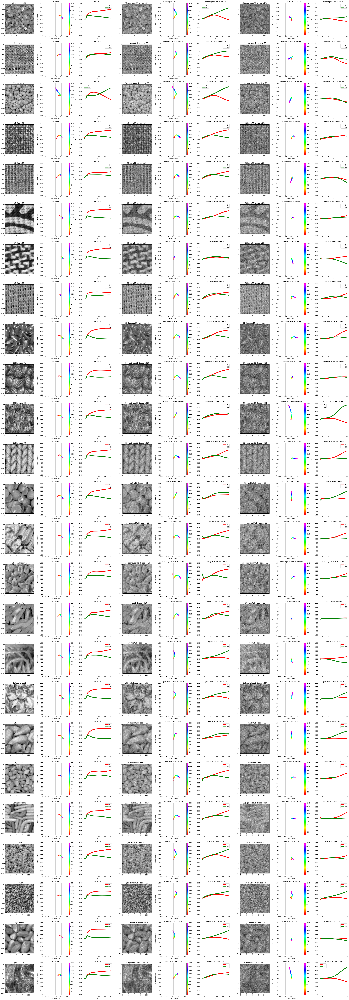

In [34]:
mean_values = [-30, 0, 30]
# sd_values = [0, 20, 50]
sd_values = [20, 50] # dont wants sd=0
amountOfImages = 25 # must be less or equal to 25
ncolsChosen = 9
chosen_filenames = np.random.choice(filenames_dataset, amountOfImages, replace=False)
chosen_filenames.sort()
print(chosen_filenames)
# nrowsChosen = int(np.ceil(len(chosen_filenames)/ncolsChosen))
nrowsChosen = amountOfImages
fig, axs = plt.subplots(nrows=nrowsChosen, ncols=ncolsChosen, figsize=(35, 4* nrowsChosen))
# Flatten the axs array for easier indexing
# axs = axs.flatten()
images_path = f'data/Sintorn/hardware'
for i, imageName in enumerate(chosen_filenames):
    # read image
    gs_image = cv2.imread(f'{images_path}/{imageName}', cv2.IMREAD_GRAYSCALE)
    # pick a mean and sd
    mean_chosen = np.random.choice(mean_values)
    sd_chosen = np.random.choice(sd_values)

    df_filtered_no_noise = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == 0) & (image_data['sd_value'] == 0)]
    axs[i][0].imshow(gs_image, cmap='gray')
    scatter = axs[i][1].scatter(df_filtered_no_noise['Smoothness'], df_filtered_no_noise['Curve structure'], 
                             c=df_filtered_no_noise['q'], cmap='gist_rainbow')  
    axs[i][0].set_title(f"({i+1})-{imageName.split('-')[0]}")
    axs[i][2].plot(df_filtered_no_noise['q'], df_filtered_no_noise['Smoothness'], 'r', label='S', linewidth=5)
    axs[i][2].plot(df_filtered_no_noise['q'], df_filtered_no_noise['Curve structure'], 'g', label='CS', linewidth=5)  
    scatter_idxs = [(1, 0)]
    function_idxs = [(2, 0)]
    for idx, sd_chosen in enumerate(sd_values):
        # noised image
        noised_image = gaussian_noise_gs(mean_chosen, sd_chosen, gs_image)

        # Filter DataFrame for the current imageName and probability
        df_filtered = image_data[(image_data['image_name'] == imageName) & (image_data['mean_value'] == mean_chosen) & (image_data['sd_value'] == sd_chosen)]


        # Create scatter plot for Smoothness vs. Curve structure, colored by q
        axs[i][3+idx*3].imshow(noised_image, cmap='gray')
        scatter = axs[i][4+idx*3].scatter(df_filtered['Smoothness'], df_filtered['Curve structure'], 
                                c=df_filtered['q'], cmap='gist_rainbow')
        axs[i][5+idx*3].plot(df_filtered['q'], df_filtered['Smoothness'], 'r', label='S', linewidth=5)
        axs[i][5+idx*3].plot(df_filtered['q'], df_filtered['Curve structure'], 'g', label='CS', linewidth=5)
        axs[i][3+idx*3].set_title(f"({i+1})-{imageName.split('-')[0]} Noised sd {sd_chosen}")
        scatter_idxs.append((4+idx*3, sd_chosen))
        function_idxs.append((5+idx*3, sd_chosen))
    # define the scatter plot configs
    for j,sd_chosen in scatter_idxs:
        # Add colorbar for each subplot
        cbar = fig.colorbar(scatter, ax=axs[i][j])
        cbar.set_label('q')
        # Set title and labels for the subplot
        axs[i][j].set_title('No Noise' if (j==1) else f"{imageName.split('-')[0]} {f'm={mean_chosen} sd={sd_chosen}'}")
        axs[i][j].set_xlabel('Smoothness')
        axs[i][j].set_ylabel('Curve Structure')
        axs[i][j].set_xlim([-1, 1])
        axs[i][j].set_ylim([-1, 1])
        axs[i][j].grid(True)
    # define the plot configs
    for j,sd_chosen in function_idxs:
        axs[i][j].set_title('No Noise' if (j==2) else f"{imageName.split('-')[0]} {f'm={mean_chosen} sd={sd_chosen}'}")
        axs[i][j].legend()
        axs[i][j].set_ylim([-1, 1])
        axs[i][j].grid(True)
        axs[i][j].set_xlabel('q')
# Adjust layout to prevent overlap
plt.tight_layout()
# Save
plt.savefig(f'results/noise_analysis/gaussian/planes/gaussian_dataset_sample_comparing_v4.png', bbox_inches='tight')
# Show the plot
plt.show()